In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

from sklearn.model_selection import train_test_split 
from sklearn.ensemble import IsolationForest
from sklearn.datasets import make_blobs
import shap

RANDOM_STATE = np.random.RandomState(42)

shap.initjs()


 # Simulation (Isolation Forest and Shapley Values)

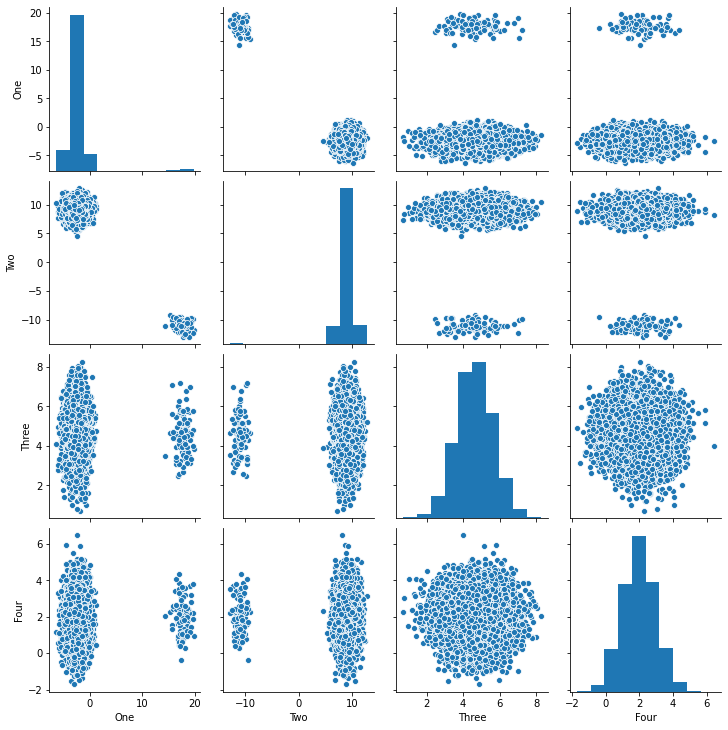

In [2]:
n_samples = 10_000
n_outliers = int(n_samples * .01)
X, _ = make_blobs(n_samples=n_samples, centers=1, n_features=4, random_state=RANDOM_STATE)
df = pd.DataFrame(X, columns=["One", "Two", "Three", "Four"])
df.iloc[-n_outliers:, 0] = df.iloc[-n_outliers:, 0]  + 20
df.iloc[-n_outliers:, 1] = df.iloc[-n_outliers:, 1]  - 20
sns.pairplot(df)


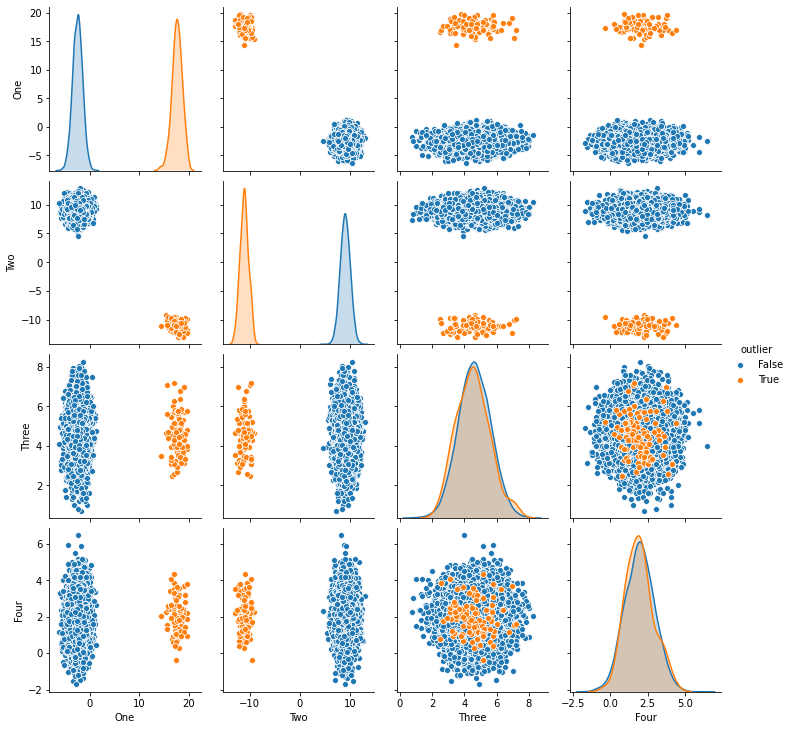

In [3]:
X_train, X_test = train_test_split(df, random_state=RANDOM_STATE)
iso = IsolationForest(n_estimators=1_000, contamination=0.01).fit(df)
predict = iso.predict(df)
outlier_mask = np.where(predict == -1, True, False)
df_ = df.copy()
df_["outlier"] = outlier_mask
sns.pairplot(df_, hue="outlier")


In [4]:
explianer = shap.TreeExplainer(iso)
shap_values = explianer.shap_values(df)


In [5]:
# Inlier
shap.force_plot(explianer.expected_value, shap_values[0, :], df.iloc[0, :])


In [6]:
# Outlier
shap.force_plot(explianer.expected_value, shap_values[-1, :], df.iloc[-1, :])


In [7]:
# Outliers
shap.force_plot(explianer.expected_value, shap_values[outlier_mask, :], df[outlier_mask])



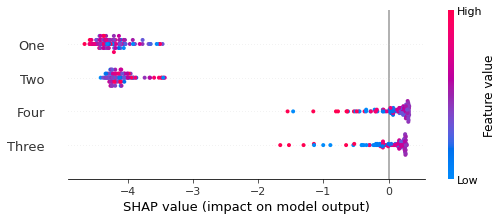

In [8]:
shap.summary_plot(shap_values[outlier_mask, :], df[outlier_mask])


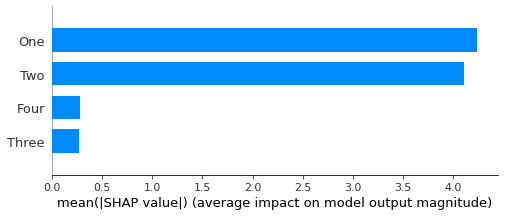

In [9]:
shap.summary_plot(shap_values[outlier_mask, :], df[outlier_mask], plot_type="bar")
